In [237]:
# library(SingleCellExperiment)
# library(scran)
# library(scater)

In [238]:
filename = "/hps/nobackup/stegle/users/acuomo/all_scripts/covid/full_counts_sce.Rds"

In [239]:
sce_all = readRDS(filename)
sce = sce_all

In [240]:
# make sure to remove pre-existing size factors, previously computed log counts
assay(sce, "logcounts") <- NULL
sizeFactors(sce) <- NULL

In [241]:
##### Note this step is hard-coded
# partial and full datasets might not and often will not be subsamples of a single sce object

In [242]:
table(sce$dataset)


   Groningen_Nawijn_2019VieiraBraga   Northwestern_Misharin_2018Reyfman 
                              11110                               41778 
         Sanger_Meyer_2019Madissoon Vanderbilt_Kropski_bioRxivHabermann 
                              56711                               31644 

In [243]:
sce = sce[,sce$dataset == 'Northwestern_Misharin_2018Reyfman']

In [244]:
table(sce$sample)


Donor_01 Donor_02 Donor_03 Donor_04 Donor_05 Donor_06 Donor_07 Donor_08 
    5436     3858     5235     5191     5341     4300     7516     4901 

In [245]:
samples = unique(sce$sample)
samples = samples[order(samples)]
samples

[1] "Donor_01" "Donor_02" "Donor_03" "Donor_04" "Donor_05" "Donor_06" "Donor_07"
[8] "Donor_08"

In [246]:
mydir = "/hps/nobackup/stegle/users/acuomo/all_scripts/covid/variance_dfs/"
rey_dir = paste0(mydir,"Reyfman_folder/")

In [247]:
select_genes <- function(dec,n){
    dec = dec[order(dec$mean),]
    m = min(dec$mean)
    M = max(dec$mean)
    genes = c()
    for (i in seq(m,M,length.out=n)){
        genes = c(genes,names(head(dec$mean[dec$mean>i],1)))
    }
    genes
}

In [248]:
for (sample in samples[7]){
    sample1 = sample
    print(sample1)
    for (sample in samples[8]){
        sample2 = sample
        if (sample1 == sample2){next}
#         print(sample2)
        sce1 = sce_all[,sce_all$sample == sample1]
        sce2 = sce_all[,sce_all$sample == sample2]
#         sce_all = sce
        sce_all1 = sce1
        sce_all2 = sce2
        celltypes1 = as.character(unique(sce1$ann_level_3))
        celltypes2 = as.character(unique(sce2$ann_level_3))
        celltypes = celltypes1[celltypes1 %in% celltypes2]
        celltypes = celltypes[!(is.na(celltypes))]
        for (celltype in celltypes){
#             print(celltype)
            sce1 = sce_all1[,sce_all1$ann_level_3 == celltype]
            sce2 = sce_all2[,sce_all2$ann_level_3 == celltype]
            if (ncol(sce1) ==1 | ncol(sce2) ==1){break}
            ## sce1
            sce = sce1
            # use edgeR to compute (log2) CPM
            logcounts(sce) = edgeR::cpm(counts(sce), log = TRUE, prior.count = 0.1)
            # compute mean variance trend (for sce1)
            dec1 <- scran::modelGeneVar(sce)
            sce1 = sce
            ## sce1
            sce = sce2
            # use edgeR to compute (log2) CPM
            logcounts(sce) = edgeR::cpm(counts(sce), log = TRUE, prior.count = 0.1)
            # compute mean variance trend (for sce2, before subsetting to only few genes)
            dec2 <- scran::modelGeneVar(sce)
            # select (10 genes) at intervals along the mean
            selected_genes = select_genes(dec2, n=11)
            ## now actually make sce2 partial
            # after saving total counts
            sce$total_counts = colSums(counts(sce))
            # select down on only present genes
            sce = sce[selected_genes,]
            assay(sce, "logcounts") <- NULL
            # re normalise (using total counts)
            logcounts(sce) = edgeR::cpm(counts(sce), log = TRUE, lib.size = sce$total_counts, prior.count = 0.1)
            sce2 = sce
            # make df to save
            df = data.frame(mean = rowMeans(logcounts(sce2)), 
                        sampled_variance = rowVars(logcounts(sce2)),
                       est_from_full_variance = metadata(dec1)$trend(rowMeans(logcounts(sce2))),
                       est_from_partial_variance_when_present = metadata(dec2)$trend(rowMeans(logcounts(sce2))))
            df$n_cells_sample1 = ncol(sce1)
            df$n_cells_sample2 = ncol(sce2)
            celltype = gsub("/","_",celltype)
            celltype = gsub(" ","_",celltype)
            filename = paste0(rey_dir,"celltype_",celltype,".full_sample_",sample1,".partial_sample_",sample2,".csv")
#             print(filename)
            write.csv(df, filename)
    
}
    }
}

[1] "Donor_07"


Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in regularize.values(x, y, ties, missing(ties)):
“collapsing to unique 'x' values”Warning message in r

In [261]:
myfiles = list.files(rey_dir)
length(myfiles)

[1] 716

In [262]:
make_plotting_df <- function(df){
    df0 = df[,c("mean","sampled_variance")]
    colnames(df0) <- c("mean","variance")
    df0$type = 'sample_variance_sample2'
    df1 = df[,c("mean","est_from_full_variance")]
    colnames(df1) <- c("mean","variance")
    df1$type = 'var_estimated_from_mean_var_trend_from_sample1'
    df2 = df[,c("mean","est_from_partial_variance_when_present")]
    colnames(df2) <- c("mean","variance")
    df2$type = 'var_estimated_from_mean_var_trend_from_sample2'
    rbind(df0,df1,df2)
}

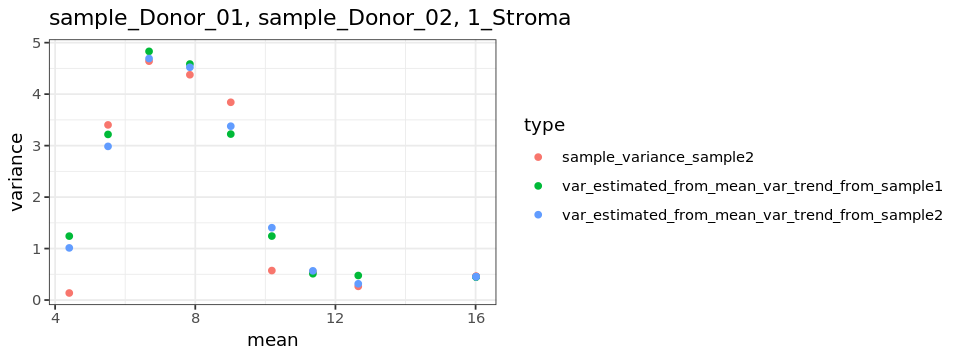

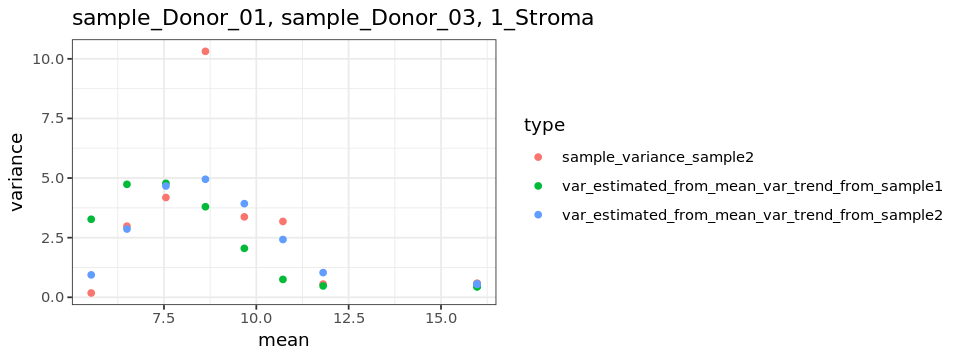

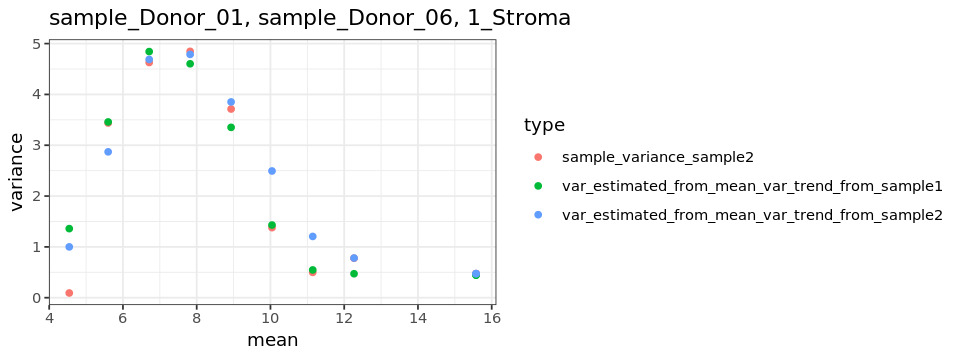

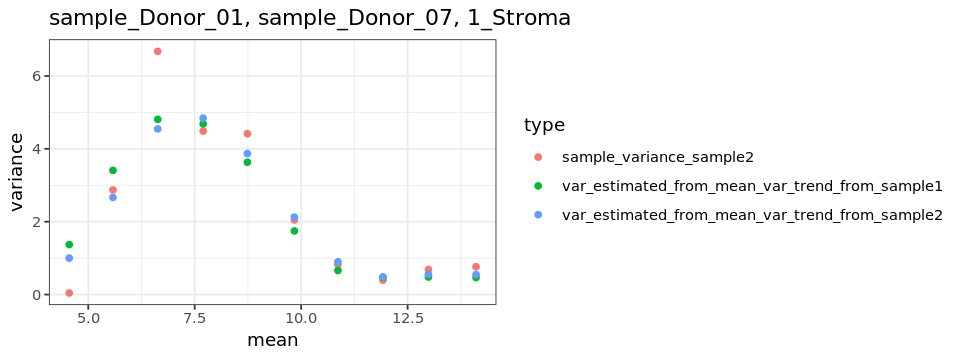

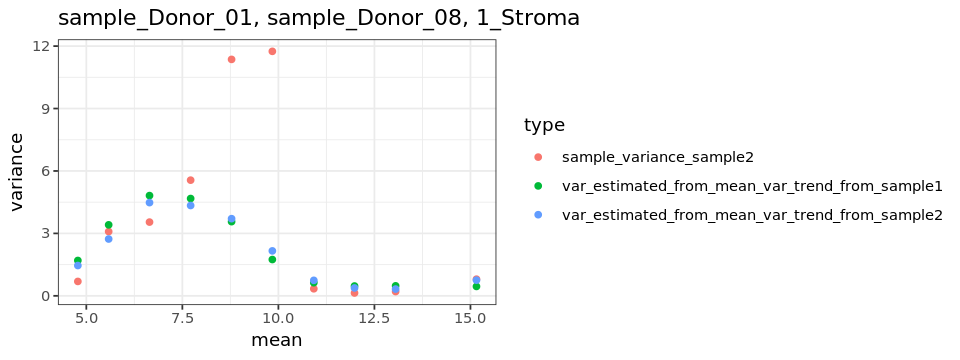

...

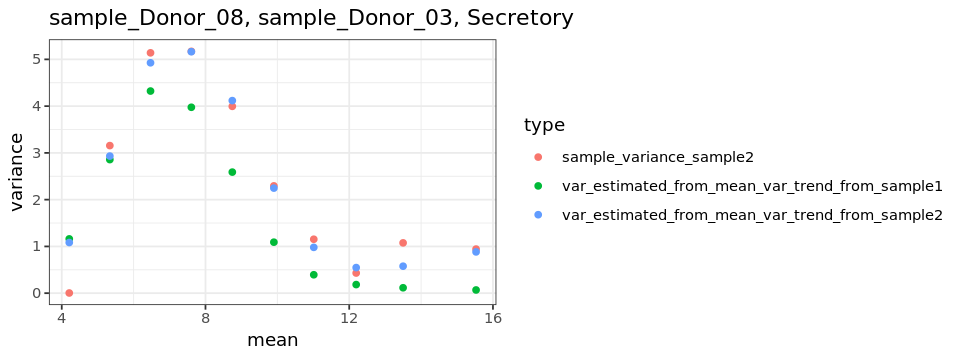

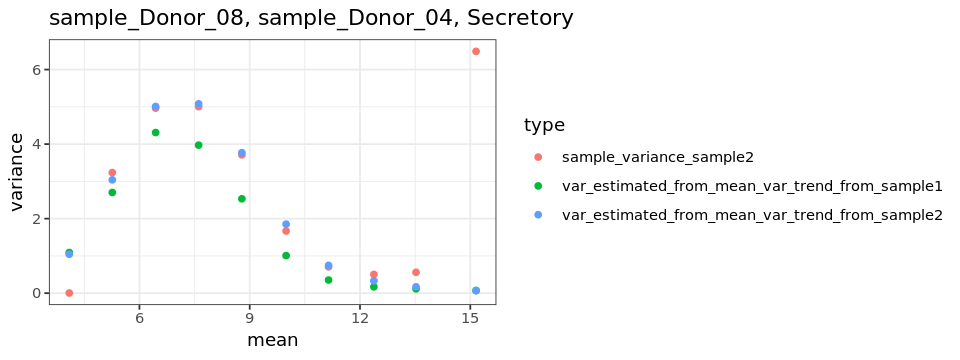

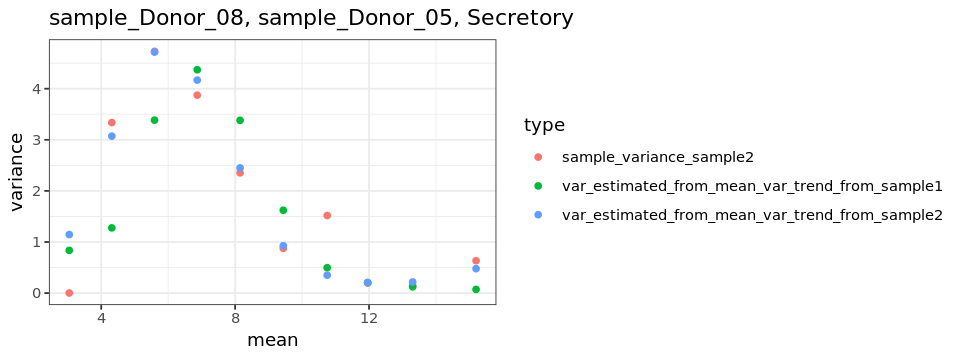

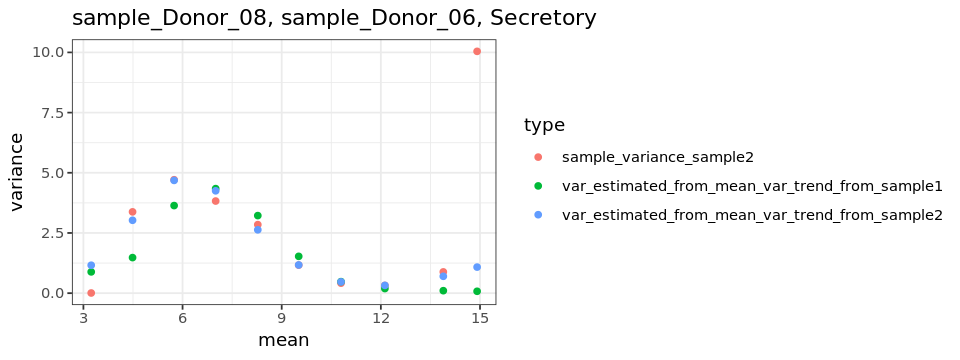

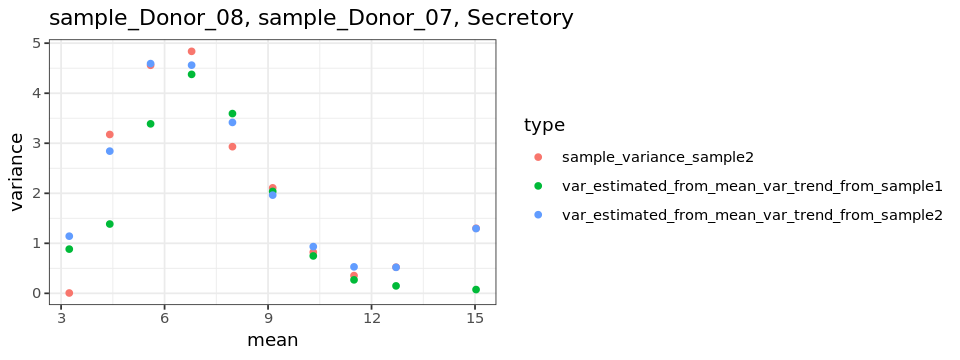

In [263]:
options(repr.plot.width = 8, repr.plot.height = 3)
for (file in myfiles){
    celltype = gsub("\\.full.*","",gsub("celltype_","",file))
    sample1 = gsub(".*\\.full_","",gsub("\\.partial_sample_.*","",file))
    sample2 = gsub(".*\\.partial_","",gsub(".csv","",file))
    filename = paste0(rey_dir,file)
    df = read.csv(filename, row.names = 1)
    plotting_df = make_plotting_df(df)
    p = ggplot(plotting_df, aes(x = mean, y = variance, col = type)) + geom_point() + theme_bw()
    print(p + ggtitle(paste0(sample1,", ",sample2,", ",celltype)))
}

In [264]:
get_distance_from_df <- function(df){
    df$dist = abs(df$sampled_variance-df$est_from_full_variance)
    mean(df$dist)
}

In [265]:
dist_df = data.frame()

In [266]:
for (file in myfiles){
    celltype = gsub("\\.full.*","",gsub("celltype_","",file))
    sample1 = gsub(".*\\.full_","",gsub("\\.partial_sample_.*","",file))
    sample2 = gsub(".*\\.partial_","",gsub(".csv","",file))
    filename = paste0(rey_dir,file)
    df = read.csv(filename, row.names = 1)
    dist = get_distance_from_df(df)
    dist_df = rbind(dist_df, data.frame(sample1 = sample1, sample2 = sample2, celltype = celltype, 
                                        avg_distance = dist, n_genes = nrow(df), 
                                        ncells_sample1 = df$n_cells_sample1[1], 
                                        ncells_sample2 = df$n_cells_sample2[1]))
}

In [267]:
head(dist_df)

sample1,sample2,celltype,avg_distance,n_genes,ncells_sample1,ncells_sample2
sample_Donor_01,sample_Donor_02,1_Stroma,0.3255087,10,12,37
sample_Donor_01,sample_Donor_03,1_Stroma,1.6186202,10,12,24
sample_Donor_01,sample_Donor_06,1_Stroma,0.2570707,10,12,32
sample_Donor_01,sample_Donor_07,1_Stroma,0.5761576,10,12,59
sample_Donor_01,sample_Donor_08,1_Stroma,2.2536236,10,12,10
sample_Donor_02,sample_Donor_01,1_Stroma,0.7045309,10,37,12


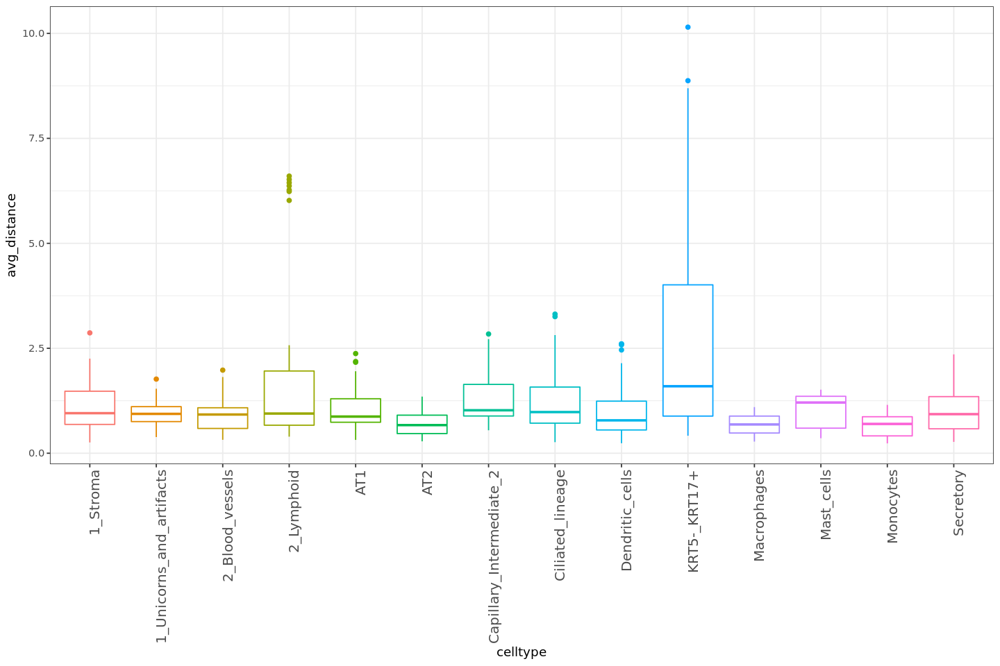

In [256]:
options(repr.plot.width = 12, repr.plot.height = 8)
ggplot(dist_df, aes(x = celltype, y = avg_distance, colour = celltype)) + geom_boxplot() + theme_bw() +
    theme(legend.position = "none", axis.text.x = element_text(angle = 90, hjust = 1, size = 12))

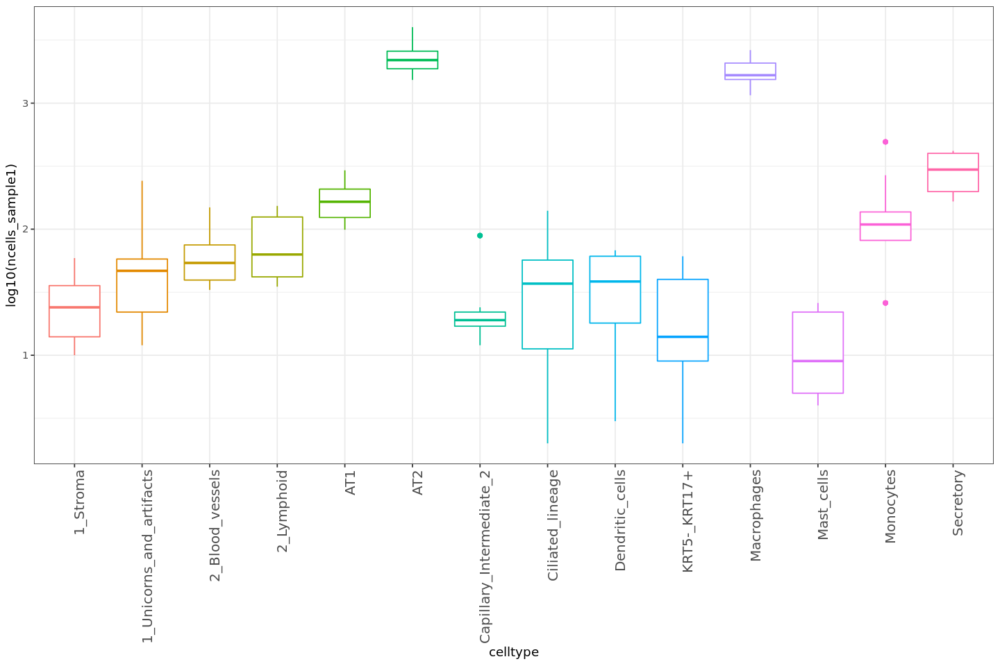

In [257]:
options(repr.plot.width = 12, repr.plot.height = 8)
ggplot(dist_df, aes(x = celltype, y = log10(ncells_sample1), colour = celltype)) + geom_boxplot() + theme_bw() +
    theme(legend.position = "none", axis.text.x = element_text(angle = 90, hjust = 1, size = 12))

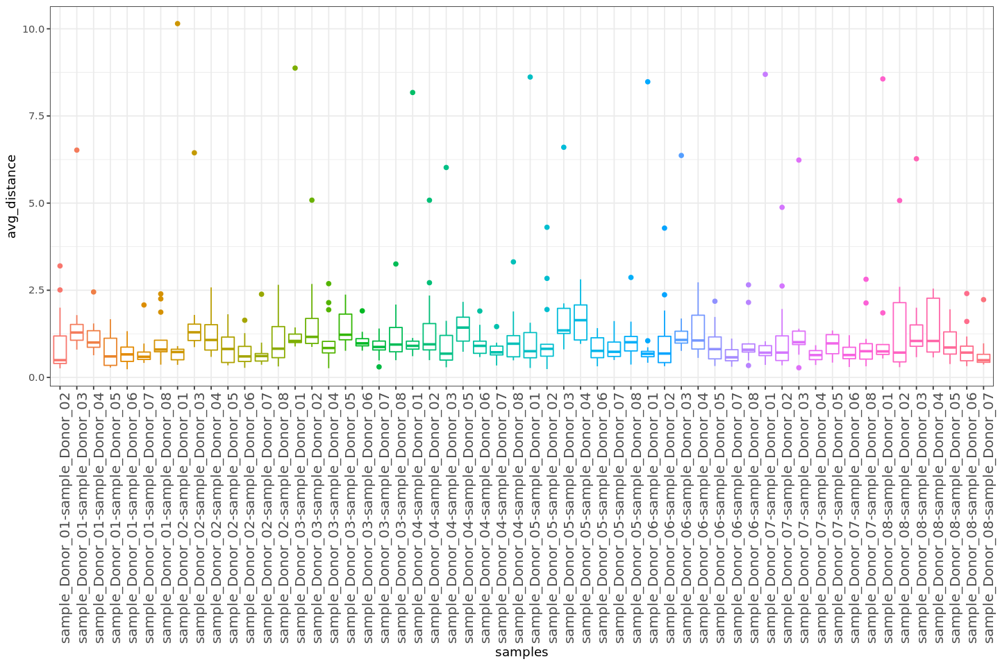

In [258]:
options(repr.plot.width = 12, repr.plot.height = 8)
dist_df$samples = paste0(dist_df$sample1,"-",dist_df$sample2)
ggplot(dist_df, aes(x = samples, y = avg_distance, colour = samples)) + geom_boxplot() + theme_bw() +
    theme(legend.position = "none", axis.text.x = element_text(angle = 90, hjust = 1, size = 12))

[1] 716

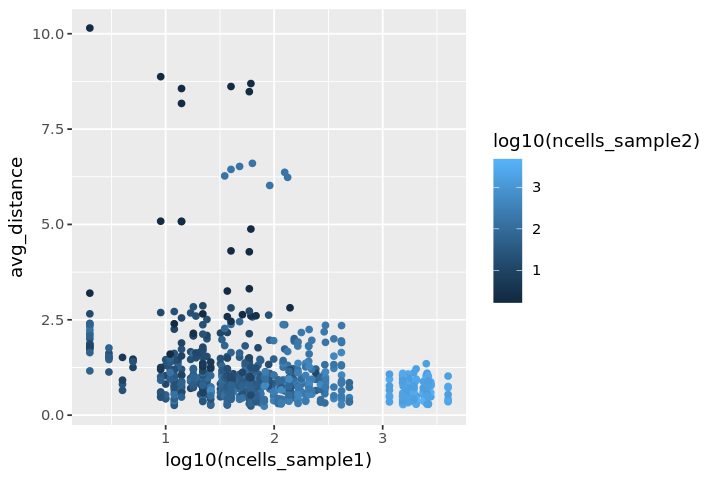

In [259]:
options(repr.plot.width = 6, repr.plot.height = 4)
nrow(dist_df)
ggplot(dist_df, aes(x = log10(ncells_sample1), y = avg_distance, colour = log10(ncells_sample2))) + geom_point()